# **4 - Stima della traspirazione**

# Sommario
    
* [Prospero](#Teoria) 
* [Input iniziali per il calcolo della traspirazione](#data)
* [Traspirazione potenziale con diversi input di LAI](#potential)
    - [LAI costante](#LAI_1)
    - [LAI sinuisoidale](#LAI_sin)
    - [Confronto delle due stime](#LAI_confronto)
* [Traspirazione con stress idrici](#water_stress)
    - [Soil Moisture corretto](#soil_moisture)
* [Traspirazione con stress ambientali](#environmental_stress)
* [Traspirazione effettiva](#totalstress)
* [Confronto Traspirazioni ottenute](#confrontoT)
* [Confronto temperatura fogliare](#confrontoLT)
* [Confronto traspirazione di due colture](#con_melo)


# Modello di Prospero <a class="anchor" id="Teoria"></a>
Come detto precedentemente, l'evapotraspirazione è data dalla combinazione di due bilanci: evaporazione del suolo e traspirazione delle piante. 

Prospero permette di stimare la traspirazione a partire dal metodo di [Schymanski-Or](https://hess.copernicus.org/articles/21/685/2017/), in modo da includere nel bilancio la dipendenza dalla superficie traspirante e la conduttanza degli stomi. 

In questo modo si ottiene un sistema di quattro equazioni lineari, in funzione della temperatura delle foglie, tensione di vapore, calore sensibile e infine della traspirazione:

$$
\begin{equation}
   \begin{cases}
   T_{\Delta}=\frac{\gamma}{a_{sH}\ C_{Dr}\gamma+a_{sE}\ C_{Da}\Delta_{e{T}}}\cdot\frac{R_{s}-R_{ll}-S_{nk}}{\rho_{a} \bar u c_{p}}-\frac{C_{Da}}{a_{sH}\ C_{Dr}\gamma+a_{sE}\ C_{Da}\Delta_{e{T}}}\cdot \delta e(z)\\e_{\Delta}=\frac{\gamma\Delta_{e{T}}}{a_{sH}\ C_{Dr}\gamma+a_{sH}\ C_{Da}\Delta_{e{T}}}\cdot\frac{R_{s}-R_{ll}-S_{nk}}{\rho_{a} \bar u c_{p}}-\frac{a_{sH}\ C_{Dr}\gamma+(a_{sE}-1)\ C_{Da}\Delta_{e{T}}}{a_{sH}\ C_{Dr}\gamma+a_{sH}\ C_{Da}\Delta_{e{T}}}\cdot \delta e(z)\\H=\frac{C_{Dr}\gamma}{a_{sH} C_{Dr}\gamma+a_{sE}C_{Da}\Delta_{e{T}}}\cdot(R_{s}-R_{ll}-S_{nk})+\frac{\rho_{a}\bar u\ c_{p}\ C_{Dr}\ C_{Da}}{a_{sH}\ C_{Dr}\gamma+a_{sE}\ C_{Da}\Delta_{e{T}}}\cdot \delta e(z)\\\lambda E_{T}=\frac{C_{Da}\Delta_{e{T}}}{ C_{Dr}\gamma+a_{sE}C_{Da}\Delta_{e{T}}}\cdot(R_{s}-R_{ll}-S_{nk})+\frac{\rho_{a}\bar u\ c_{p}\ a_{sE}\ C_{Dr}\ C_{Da}\ +(a_{sE}-1)\ C_{Da}^2\Delta_{e{T}}\gamma^{-1} }{a_{sH}\ C_{Dr}\gamma+a_{sE}\ C_{Da}\Delta_{e{T}}}\cdot \delta e(z)
   \end{cases} 
\end{equation}
$$

Per ottenere l'evapotraspirazione effettiva, moltiplica l'evapotraspirazione potenziale a un fattore che riunisce gli stress $gs$ compreso tra 0 ed 1 che taglia linearmente l’evapotraspirazione. Proprio in questo Prospero si differenzia dagli altri metodi: tale prodotto avviene all'interno del sistema di equazioni, in modo da risolvere il bilancio energetico della foglia considerando la traspiraizone effettiva:
\begin{equation}
ET_{eff}=ET_{pot}\cdot g_{s}
\end{equation}

\begin{equation}
g_{s} = g_{s}max\cdot f(R_{par})\cdot f(T_{a})\cdot f(VPD) \cdot K_{s}
\end{equation}

where:
- $g_{s}max $: conduttanza degli stomi in condizioni ottimali di irrigazione e assenza di alcun tipo di stress; 
- $f(R_{par})$: coefficiente di stress, funzione della radiazione fotosinticamente attiva;
- $f(T_{a})$: coefficiente di stress, funzione della temperatura dell'aria;
- $f(VPD) $: coefficiente di stress, funzione del deficit della tensione di vapore;
- $K_{s} $:  coefficiente di stress, funzione del contenuto d'acqua.

In [1]:
import os
import warnings
import datetime
import warnings
import numpy as np
import pandas as pd
import xarray as xr
from matplotlib import rc
import plotly.express as px
import matplotlib.pyplot as plt
import matplotlib.style as style
import matplotlib.dates as mdates
from IPython.display import Image
from GEOSPACE_Output import*
warnings.filterwarnings('ignore')
warnings.simplefilter(action='ignore', category=FutureWarning)
oms_project_path = os.path.dirname(os.getcwd())
from IPython.display import Image

In [2]:

os.chdir(os.path.join(os.getcwd(), "..", "output", "Cavone", "1"))
oms_project_path = os.path.dirname(os.getcwd())

## Stima della Traspirazione  $[mm]$ <a class="anchor" id='data'></a>
Sono stati considerate tali condizioni:
- Traspirazione potenziale con LAI costante pari a 1
- Traspirazione potenziale con LAI variabile (sinuisoidale): $5$ (pino silvestre) e $10$ (abete rosso) [LAI conifere](http://sanzenoneallambropgt.magnani.it/DdP/2.8%20allegato%20indice%20fogliare.pdf)
- Stima della traspirazione da soli fattori ambientali, dal solo stress idrico ed effettiva (valutati con LAI sinuisoidale)
- Umidità del suolo (*soil moisture*): variabile (sinuisoidale)
- Stazione: Cavone (1)
- Suolo *Silt-loam* (limo-argilloso), caratterizzato da:
    * $\theta_{FC}$ (*Water Field Capacity*): $0.29$ [-]
    * $\theta_{WC}$ (*Water Wilting Point*): $0.15$ [-]
- Coltura di conifere, caratterizzata da:
    * $Z_r$ (*roots depth*): $1.25$ [$m$] 
    * $p$ (*Depletion Fraction*): $0.7$ [-]
    * $K_{c, end}$ (*Crop Coefficient*): $1$ [-]
    * Altezza della pianta: $10$ [$m$]

Uno degli imput richiesti dal programma è quello di inserire una serie temporale per l'**indice di area fogliare: _LAI_**. 

Tale indice corrisponde a una quantità adimensionale che varia in base al tipo di vegetazione che abbiamo: nel caso delle latifoglie descrive la misura di superficie fogliare per unità di superficie del suolo; le conifere invece hanno bisogno di una diversa definizione perché non rappresenta l'effettiva superficie di scambio, in quanto sono caratterizzate da aghi a sezione circolare o semicircolare.  Per evitare il problema dovuto alla forma delle foglie, alcuni autori (Smith, 1991; Bolstad e Gower, 1990) proposero di modificare il parametro, introducendo l'area fogliare proiettata. ([Indice di Area Fogliare - Wikipedia](https://it.wikipedia.org/wiki/Indice_di_area_fogliare)).

# Traspirazione potenziale <a class='anchor' id='potential'> </a>

### LAI costante <a class='anchor' id='LAI_1'> </a>

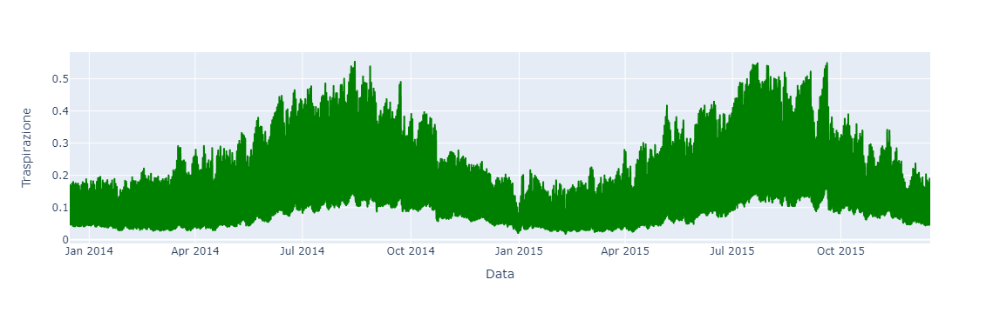

In [13]:
df = pd.read_csv('Transpiration_1_potential.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df.columns = ['Data','Traspirazione']
fig = px.line(df, x='Data', y='Traspirazione')
fig.update_traces(line_color='green')
fig.show()

### LAI sinuisoidale <a class='anchor' id='LAI_sin'> </a>

Modificando il file inserito per l'indice LAI in una serie temporale sinuisoidale di una conifera:

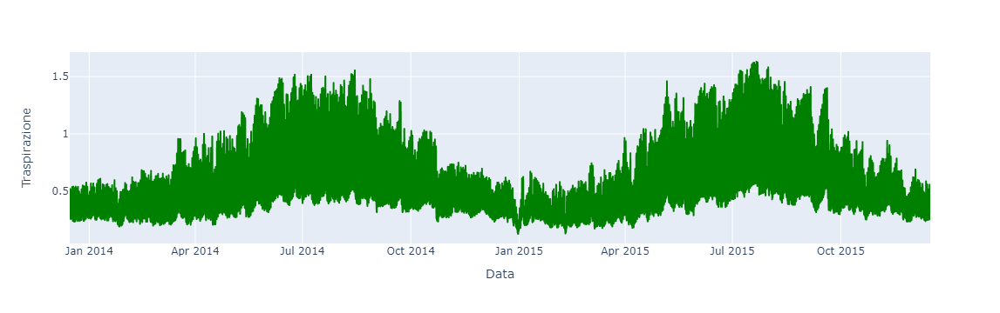

In [4]:
df2 = pd.read_csv('Con_Transpiration_1_potential.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df2.columns = ['Data','Traspirazione']
fig = px.line(df2, x='Data', y='Traspirazione')
fig.update_traces(line_color='green')
fig.show()

## Confronto stime della traspirazione potenziale <a class='anchor' id='LAI_confronto'> </a>

Faccio un confronto tra i due risultati ottenuti:

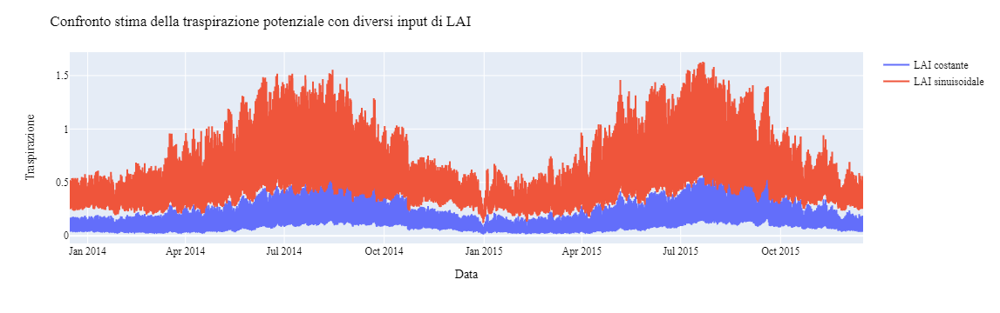

In [5]:
fig = px.line()
import plotly.graph_objects as go
fig.add_trace(go.Scatter(x=df['Data'], y=df['Traspirazione'], mode='lines', name='LAI costante'))
fig.add_trace(go.Scatter(x=df2['Data'], y=df2['Traspirazione'], mode='lines', name='LAI sinuisoidale'))

fig.update_layout(
    title='Confronto stima della traspirazione potenziale con diversi input di LAI',
    xaxis_title="Data",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Traspirazione",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

Il confronto tra i grafici della traspirazione che si ottengono con LAI costante e con LAI sinusoidale evidenzia quanto questo fattore influenzi il risultato finale: i valori che troviamo con LAI costante sono meno variabili ma anche decisamente minori rispetto a quelli ricavati con LAI sinusoidale.

# Stima della Traspirazione con stress idrico <a class='anchor' id='water_stress'> </a>

### Stima iniziale con Soil Moisture non adeguato

Il risultato trovato inizialmente per la traspirazione con stress idrico rispecchia dei valori del parametro che definisce il Soil Moisture non adatti: presentando infatti delle oscillazioni tra $0.05$ e $0.2$ vengono esclusi tutti i dati non compresi tra il Wilting Point ($0.15$) e la Field Capacity ($0.29$).


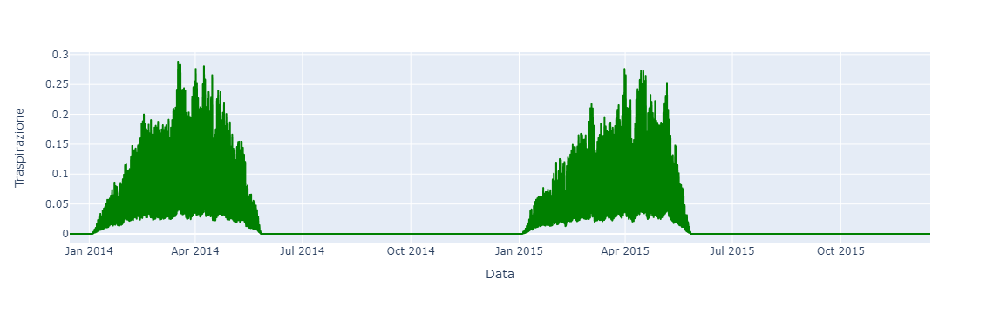

In [6]:
df4 = pd.read_csv('Transpiration_1_waterstress.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df4.columns = ['Data','Traspirazione']
fig = px.line(df4, x='Data', y='Traspirazione')
fig.update_traces(line_color='green')
fig.show()

Il grafico sottostante mostra come gli unici valori che il programma considera in queste condizioni siano quelli compresi nella parte superiore alla retta rossa e sotto la sinusoide:
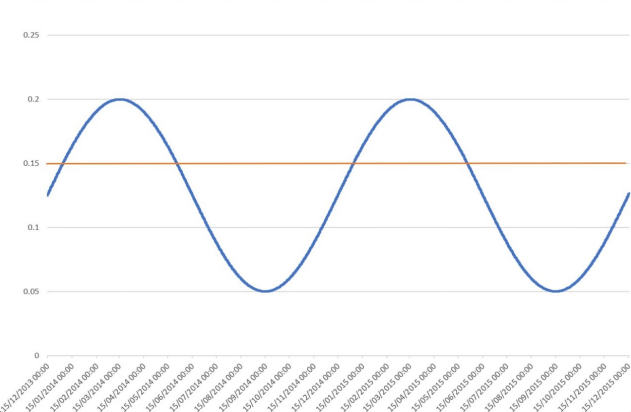

### Stima con un Soil Moisture corretto <a class='anchor' id='soil_moisture'> </a>

Per trovare un risultato migliore è necessario ripetere la simulazione, cambiando il valore del *Soil Moisture* e imponendo ad esempio oscillazioni tra il valore di *Wilting Point* e quello di *Field Capacity* relativi al suolo che stiamo considerando (Silt Loam). 

I risultati che si ottengono in questo caso, considerando un andamento sinuisoidale del *LAI* relativo alla coltura delle conifere (compreso tra $5$ e $10$), sono esposti in seguito:

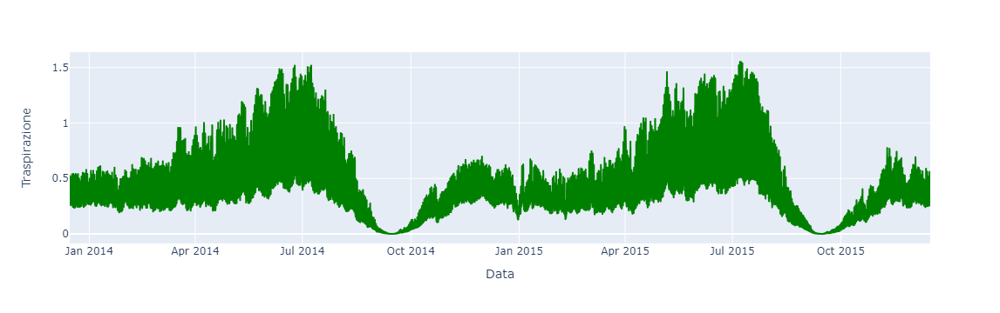

In [7]:
df8 = pd.read_csv('Con_Transpiration_1_waterstress.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df8.columns = ['Data','Traspirazione']
fig = px.line(df8, x='Data', y='Traspirazione')
fig.update_traces(line_color='green')
fig.show()

# Stima della Traspirazione con stress ambientali  <a class='anchor' id='environmental_stress'> </a>

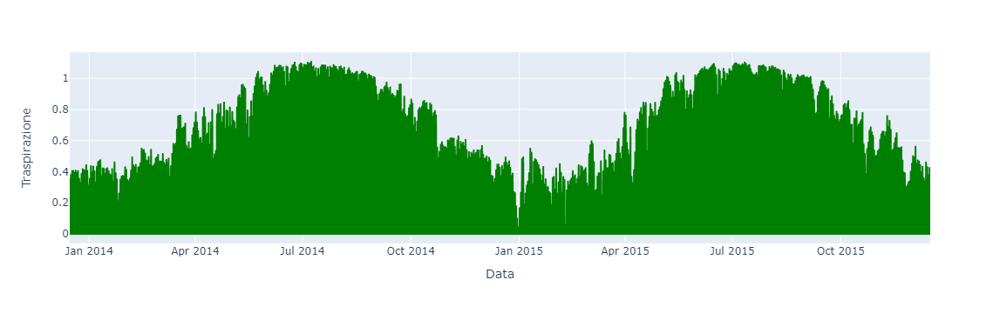

In [8]:
df9 = pd.read_csv('Con_Transpiration_1_environmentalstress.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df9.columns = ['Data','Traspirazione']
fig = px.line(df9, x='Data', y='Traspirazione')
fig.update_traces(line_color='green')
fig.show()

# Stima della Traspirazione effettiva  <a class='anchor' id='totalstress'> </a>

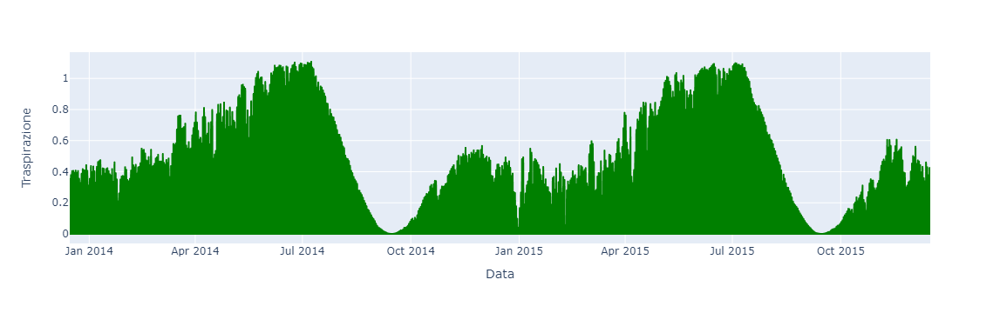

In [9]:
df11 = pd.read_csv('Con_Transpiration_1_totalstress.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df11.columns = ['Data','Traspirazione']
fig = px.line(df11, x='Data', y='Traspirazione')
fig.update_traces(line_color='green')
fig.show()

# Confronto delle diverse stime di traspirazione per una conifera <a class='anchor' id='confrontoT'> </a>

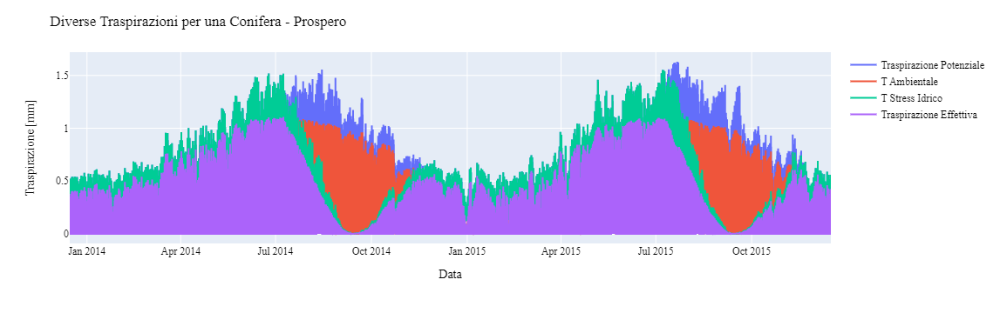

In [10]:
fig = px.line()
fig.add_trace(go.Scatter(x=df2['Data'], y=df2['Traspirazione'], mode='lines', name='Traspirazione Potenziale'))
fig.add_trace(go.Scatter(x=df9['Data'], y=df9['Traspirazione'], mode='lines', name='T Ambientale'))
fig.add_trace(go.Scatter(x=df8['Data'], y=df8['Traspirazione'], mode='lines', name='T Stress Idrico'))
fig.add_trace(go.Scatter(x=df11['Data'], y=df11['Traspirazione'], mode='lines', name='Traspirazione Effettiva'))

fig.update_layout(
    title='Diverse Traspirazioni per una Conifera - Prospero',
    xaxis_title="Data",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Traspirazione [mm]",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

La traspirazione, soprattutto tenendo conto dello stress idrico, risente in questo caso molto dell'andamento stagionale: si trovano infatti dei massimi molto marcati nei mesi estivi e dei minimi in ottobre.

Inoltre, si può notare che la traspirazione effettiva è influenzata soprattutto dai fattori di stress idrico, in quanto mostrano lo stesso andamento al variare del tempo. 

In generale comunque la considerazione di tutti gli stress nel bilancio porta a una riduzione significativa dei valori di traspirazione: nel caso dei valori di minimo decrescono fino a zero, i massimi valori potenziali (attorno a $1.6$ $[mm]$) si riducono di circa $0.5$ $[mm]$ di acqua traspirata.

## Confronto temperatura fogliare - Traspirazione effettiva <a class='anchor' id='confrontoLT'> </a>

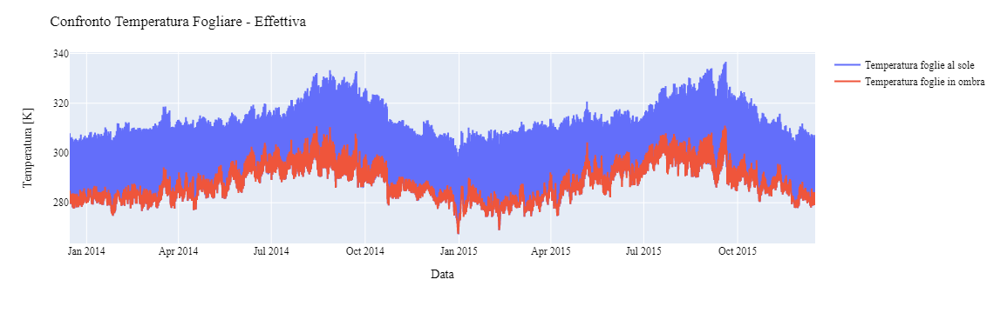

In [16]:
#temperatura foglie al sole
df0 = pd.read_csv('Con_LT_Sun_1_totalstress.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df0.columns = ['Data','LeafTemperature']
#Temperatura foglie in ombra
df12 = pd.read_csv('Con_LT_Shade_1_totalstress.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df12.columns = ['Data','LeafTemperature']

#confronto:
fig = px.line()
fig.add_trace(go.Scatter(x=df0['Data'], y=df0['LeafTemperature'], mode='lines', name='Temperatura foglie al sole'))
fig.add_trace(go.Scatter(x=df12['Data'], y=df12['LeafTemperature'], mode='lines', name='Temperatura foglie in ombra'))


fig.update_layout(
    title='Confronto Temperatura Fogliare - Effettiva',
    xaxis_title="Data",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Temperatura [K]",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

Anche in questo caso, si può confermare che l'andamento della temperature delle foglie dipende da fattori stagionali. è evidente che la temperatura delle foglie in ombra è chiaramente inferiore alla temperatura delle foglie al sole ($23 °C$ il 27 agosto 2014).

La temperatura delle foglie al sole hanno dei picchi di $330 [K]$ (circa $55°C$), temperature realistiche per una vegetazione in condizioni di grande insolazione ed elevato stress. In queste condizioni la vegetazione non si trova nel suo optimum di traspirazione: infatti come si vede dal grafico della traspirazione effettiva, tali temperature corrispondono ai periodi in cui si riscontrano valori prossimi ai $0$ [$mm$] di acqua traspirata (ad esempio il 21 settembre 2014). Viceversa, i massimi [$mm$] di acqua traspirata coincidono con una temperatura delle foglie al sole di circa $317 [K]$ (circa $44 [°C]$) (6 luglio 2014).

Se mettiamo a confronto la temperatura massima delle foglie al sole potenziale con quella effettiva notiamo che nel primo caso non vengono raggiunti valori altrettanto elevati (con picchi inferiori anche di circa $20 °C$ - 5 settembre 2015), proprio perchè considerando condizioni di stress, la temperatura fogliare aumenta: 

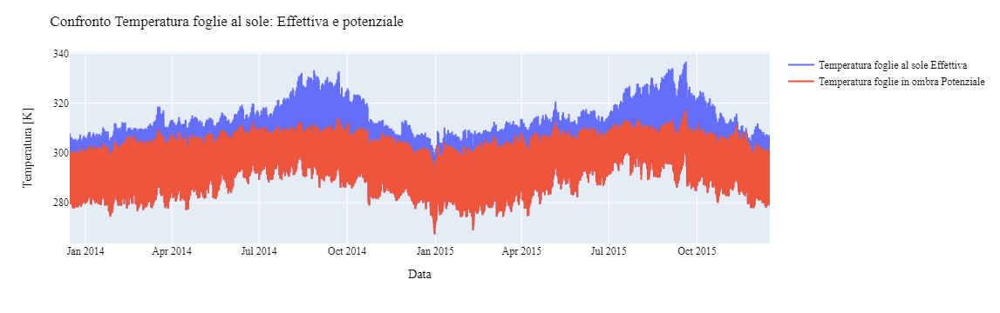

In [17]:
#temperatura foglie al sole
df0 = pd.read_csv('Con_LT_Sun_1_totalstress.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df0.columns = ['Data','LeafTemperature']
#Temperatura foglie in ombra
df20 = pd.read_csv('Con_LT_Sun_1_potential.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df20.columns = ['Data','LeafTemperature']

#confronto:
fig = px.line()
fig.add_trace(go.Scatter(x=df0['Data'], y=df0['LeafTemperature'], mode='lines', name='Temperatura foglie al sole Effettiva'))
fig.add_trace(go.Scatter(x=df20['Data'], y=df20['LeafTemperature'], mode='lines', name='Temperatura foglie in ombra Potenziale'))


fig.update_layout(
    title='Confronto Temperatura foglie al sole: Effettiva e potenziale',
    xaxis_title="Data",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Temperatura [K]",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

# Confronto Traspirazione di due diverse colture <a class='anchor' id='con_melo'> </a>
A seconda della vegetazione scelta, la stima della traspirazione porterà a dei risultati differenti. 

Ad esempio, abbiamo scelto di mettere a confronto la stima precedente con la traspirazione effettiva di un Meleto, sulla stessa tipologia di suolo. I parametri utilizzati sono quindi:
- $Z_r$ (*roots depth*): $1.5$ [$m$]
- $p$ (*Depletion Fraction*): $0.5$ [-]
- $K_{c, end}$ (*Crop Coefficient*): $0.75$ [-]
- Altezza della pianta: $6$ [$m$]
- LAI meleto: $1.80 ± 0.25$ [-] (Jackson, 1978) -  [American Society for Horticultural Science](https://journals.ashs.org/hortsci/view/journals/hortsci/53/6/article-p799.xml#:~:text=Previous%20literature%20states%20that%20an,0.25%20(Jackson%2C%201978) )

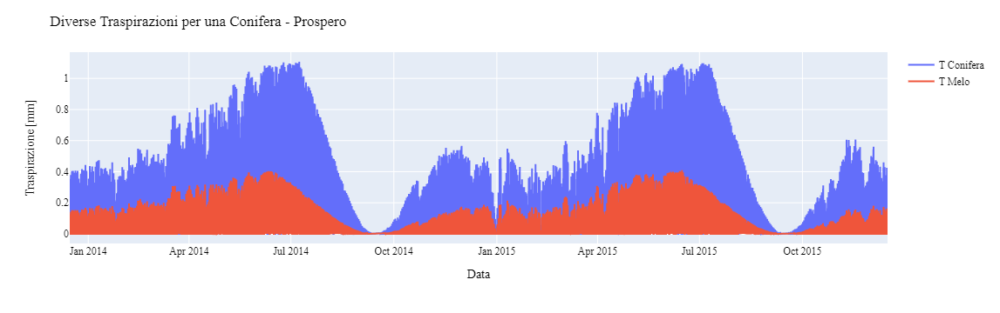

In [12]:
#Traspirazione di un melo
df13 = pd.read_csv('Melo_Transpiration_1_totalstress.csv',skiprows=6, sep=',', parse_dates=[0], na_values=-9999,usecols=[1,2])
df13.columns = ['Data','Traspirazione Melo']

fig = px.line()
fig.add_trace(go.Scatter(x=df11['Data'], y=df11['Traspirazione'], mode='lines', name='T Conifera'))
fig.add_trace(go.Scatter(x=df13['Data'], y=df13['Traspirazione Melo'], mode='lines', name='T Melo'))

fig.update_layout(
    title='Diverse Traspirazioni per una Conifera - Prospero',
    xaxis_title="Data",
    font_family="Times New Roman",
    font_color="Black",
    title_font_family="Times New Roman",
    title_font_color="Black",
    yaxis_title="Traspirazione [mm]",
    #legend_title="Date",
    font=dict(size=12))
fig.show()

Si nota immediatamente che gli andamenti delle due stime differiscono di molto: la traspirazione per una conifera risulta essere sempre maggiore o uguale del melo. Inoltre, c'è una grande differenza anche tra i massimi valori di traspirazione ottenuti: il valor massimo raggiunto nel caso del melo ( $0.40$ [$mm$] ) risulta essere meno della metà del massimo raggiunto per la conifera ( $1.10$ [$mm$] ). 

Questo risultato probabilmente in gran parte è dovuto al fatto che le due piante sono caratterizzate da un range di *LAI* molto diversi (tra $5$ e $10$ per le conifere e tra $1.55$ e $2.05$ per il melo), che quindi comportano un'effettiva superficie di scambio molto minore.